# Load data and import library

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install scikit-fuzzy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 4.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for scikit-fuzzy: filename=scikit_fuzzy-0.4.2-py3-none-any.whl size=894078 sha256=30ad1cc5c09e0a22fabbc467807eb048e23331272743d4c64381287eee942663
  Stored in directory: /root/.cache/pip/wheels/4f/86/1b/dfd97134a2c8313e519bcebd95d3fedc7be7944db022094bc8
Successfully built scikit-fuzzy


In [3]:
import numpy as np

In [4]:
X_filepath = '/content/drive/My Drive/Alternative Assessment/final_x.npy'
y_filepath = '/content/drive/My Drive/Alternative Assessment/final_y.npy'

X = np.load(X_filepath)
y = np.load(y_filepath)

print(X.shape)
print(y.shape)

(720, 28, 28)
(720,)


In [5]:
# Define your class labels
class_labels_strings = ["Shun Qi", "Carmen", "Dernice", "Shi Ting", "Zia Qian"]

# Create a mapping from class label strings to numeric values
label_to_index = {label: index for index, label in enumerate(class_labels_strings)}
index_to_label = {index: label for label, index in label_to_index.items()}

# Convert your class labels from strings to numeric values
y = np.array([label_to_index[label] for label in y])

# Fuzzy Logic

In [6]:
import cv2
import skfuzzy as fuzz
from skfuzzy import control as ctrl

# Function to preprocess the image
def preprocess_image(image):
    return (image > 0).astype(np.uint8)

# Calculate stroke thickness
def calculate_stroke_thickness(binary_image):
    dist_transform = cv2.distanceTransform(binary_image, cv2.DIST_L2, 5)
    return np.mean(dist_transform)

# Calculate the number of strokes
def calculate_number_of_strokes(binary_image):
    num_labels, labels_im = cv2.connectedComponents(binary_image)
    return num_labels - 1 

# Calculate line straightness
def calculate_line_straightness(binary_image):
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return 0
    total_length = sum(cv2.arcLength(cnt, True) for cnt in contours)
    return total_length

# Calculate loop size
def calculate_loop_size(binary_image):
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    loop_sizes = []
    for cnt in contours:
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            loop_sizes.append(0)
        else:
            loop_sizes.append(area / perimeter)
    return np.mean(loop_sizes)

In [7]:
# Define fuzzy variables for feature extraction
stroke_thickness = ctrl.Antecedent(np.arange(0, 256, 1), 'stroke_thickness')
number_of_strokes = ctrl.Antecedent(np.arange(0, 51, 1), 'number_of_strokes')
line_straightness = ctrl.Antecedent(np.arange(0, 1.01, 0.01), 'line_straightness')
loop_size = ctrl.Antecedent(np.arange(0, 100, 1), 'loop_size')
extracted_feature = ctrl.Consequent(np.arange(0, 256, 1), 'extracted_feature')

# Define membership functions for stroke thickness
stroke_thickness['thin'] = fuzz.trimf(stroke_thickness.universe, [0, 128, 255])  
stroke_thickness['thick'] = fuzz.trimf(stroke_thickness.universe, [128, 255, 255]) 

# Define membership functions for number of strokes
number_of_strokes['few'] = fuzz.trimf(number_of_strokes.universe, [0, 25, 50]) 
number_of_strokes['many'] = fuzz.trimf(number_of_strokes.universe, [25, 50, 50]) 

# Define membership functions for line straightness
line_straightness['low'] = fuzz.trimf(line_straightness.universe, [0, 0.5, 1])  
line_straightness['high'] = fuzz.trimf(line_straightness.universe, [0.5, 1, 1])  

# Define membership functions for loop size
loop_size['small'] = fuzz.trimf(loop_size.universe, [0, 50, 100])  
loop_size['large'] = fuzz.trimf(loop_size.universe, [50, 100, 100])  

# Define membership functions for the extracted feature
extracted_feature['poor'] = fuzz.trimf(extracted_feature.universe, [0, 85, 170]) 
extracted_feature['good'] = fuzz.trimf(extracted_feature.universe, [85, 170, 255])  

# Define fuzzy rules
rule1 = ctrl.Rule(stroke_thickness['thin'] & number_of_strokes['few'] | 
                  line_straightness['low'] & loop_size['small'], extracted_feature['poor'])

rule2 = ctrl.Rule(stroke_thickness['thick'] & number_of_strokes['many'] | 
                  line_straightness['high'] & loop_size['large'], extracted_feature['good'])

# Create fuzzy control system and simulation
fuzzy_ctrl = ctrl.ControlSystem([rule1, rule2])
fuzzy_simulation = ctrl.ControlSystemSimulation(fuzzy_ctrl)

In [8]:
def fuzzy_extract_features(image):
    binary_image = preprocess_image(image)
    stroke_thickness_value = calculate_stroke_thickness(binary_image)
    number_of_strokes_value = calculate_number_of_strokes(binary_image)
    line_straightness_value = calculate_line_straightness(binary_image)
    loop_size_value = calculate_loop_size(binary_image)

    fuzzy_simulation.input['stroke_thickness'] = stroke_thickness_value
    fuzzy_simulation.input['number_of_strokes'] = number_of_strokes_value
    fuzzy_simulation.input['line_straightness'] = line_straightness_value
    fuzzy_simulation.input['loop_size'] = loop_size_value
    fuzzy_simulation.compute()

    fuzzy_output = fuzzy_simulation.output['extracted_feature']

    return [stroke_thickness_value, number_of_strokes_value, line_straightness_value, loop_size_value, fuzzy_output], label

features_list = []
class_labels_list = []

for image, label in zip(X, y):
    features, _ = fuzzy_extract_features(image)
    features_list.append(features)
    class_labels_list.append(label)

fuzzy_features = np.array(features_list)
class_labels = np.array(class_labels_list)

print("Extracted Features Shape:", fuzzy_features.shape)
print("Fuzzy Features:", fuzzy_features)
print("Class Labels:", class_labels)


Extracted Features Shape: (720, 5)
Fuzzy Features: [[  0.49654132   3.          70.87005711   1.4698262   85.        ]
 [  0.40270728   3.         104.42640591   0.48519018  85.        ]
 [  0.41058779   2.          63.69848394   3.99538551  85.        ]
 ...
 [  0.50342512   3.         107.74011469   0.57855269  85.        ]
 [  0.74745101   3.         135.63960874   0.61560189  85.        ]
 [  0.5378679    8.         112.18376529   0.1933212   85.        ]]
Class Labels: [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

In [9]:
print("Fuzzy Features Shape:", fuzzy_features.shape)

Fuzzy Features Shape: (720, 5)


In [10]:
def generate_rule(stroke_thickness, number_of_strokes, line_straightness, loop_size, extracted_feature):
    return f"IF (stroke_thickness IS {stroke_thickness} AND number_of_strokes IS {number_of_strokes} OR line_straightness IS {line_straightness} AND loop_size IS {loop_size}) THEN extracted_feature IS {extracted_feature}"

rules = [
    generate_rule('thin', 'few', 'low', 'small', 'poor'),
    generate_rule('thick', 'many', 'high', 'large', 'good')
]

for i, rule in enumerate(rules):
    print(f"Rule {i + 1}: {rule}")


Rule 1: IF (stroke_thickness IS thin AND number_of_strokes IS few OR line_straightness IS low AND loop_size IS small) THEN extracted_feature IS poor
Rule 2: IF (stroke_thickness IS thick AND number_of_strokes IS many OR line_straightness IS high AND loop_size IS large) THEN extracted_feature IS good


# Neural Network

In [11]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical

In [12]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(fuzzy_features, class_labels, test_size=0.2, random_state=42)

In [101]:
num_classes = 5

input_shape = (fuzzy_features.shape[1],)

def init():
    model = Sequential()
    model.add(Dense(128, input_shape=input_shape, activation='relu'))
    model.add(BatchNormalization())  
    model.add(Dropout(0.3)) 
    model.add(Dense(64, activation='relu'))
    model.add(BatchNormalization())  
    model.add(Dropout(0.3))
    model.add(Dense(32, activation='relu'))
    model.add(BatchNormalization()) 
    model.add(Dropout(0.3))
    model.add(Dense(num_classes, activation='softmax'))

    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

model = init()

history = model.fit(X_train, y_train, epochs=50, validation_split=0.2)

test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)


Epoch 1/50
15/15 [==============================] - 2s 21ms/step - loss: 1.8546 - accuracy: 0.3413 - val_loss: 3.1289 - val_accuracy: 0.4397
Epoch 2/50
15/15 [==============================] - 0s 8ms/step - loss: 1.6401 - accuracy: 0.3500 - val_loss: 2.3216 - val_accuracy: 0.4310
Epoch 3/50
15/15 [==============================] - 0s 8ms/step - loss: 1.5462 - accuracy: 0.3478 - val_loss: 1.8412 - val_accuracy: 0.4310
Epoch 4/50
15/15 [==============================] - 0s 7ms/step - loss: 1.4648 - accuracy: 0.3717 - val_loss: 1.6321 - val_accuracy: 0.4397
Epoch 5/50
15/15 [==============================] - 0s 8ms/step - loss: 1.3957 - accuracy: 0.3826 - val_loss: 1.4569 - val_accuracy: 0.4483
Epoch 6/50
15/15 [==============================] - 0s 9ms/step - loss: 1.3599 - accuracy: 0.3870 - val_loss: 1.3330 - val_accuracy: 0.4397
Epoch 7/50
15/15 [==============================] - 0s 9ms/step - loss: 1.3010 - accuracy: 0.4283 - val_loss: 1.2350 - val_accuracy: 0.4483
Epoch 8/50
15/15 [=

In [14]:
print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               768       
                                                                 
 batch_normalization (Batch  (None, 128)               512       
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 64)                8256      
                                                                 
 batch_normalization_1 (Bat  (None, 64)                256       
 chNormalization)                                                
                                                                 
 dropout_1 (Dropout)         (None, 64)                0

In [102]:
# Predict the labels for the test set
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

5/5 [==============================] - 0s 2ms/step


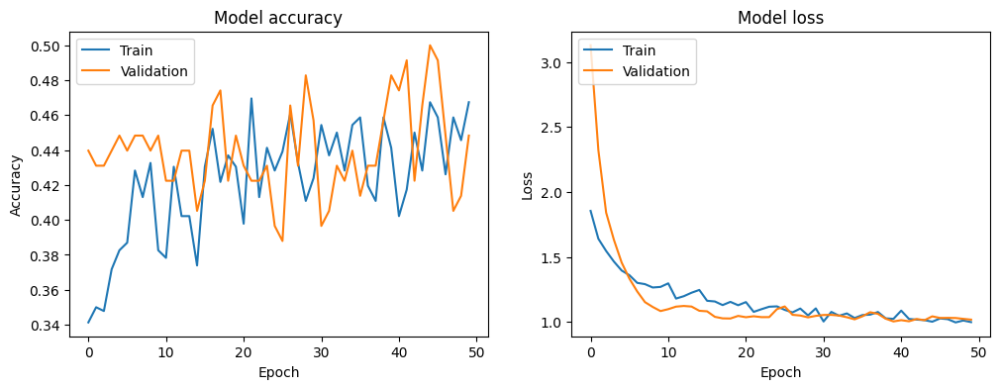

In [103]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [104]:
# Classification report
print(classification_report(y_test, y_pred_classes, target_names=class_labels_strings))

              precision    recall  f1-score   support

     Shun Qi       0.69      0.32      0.44        34
      Carmen       0.30      0.65      0.41        26
     Dernice       1.00      0.19      0.33        36
    Shi Ting       0.39      0.32      0.35        22
    Zia Qian       0.46      0.81      0.58        26

    accuracy                           0.44       144
   macro avg       0.57      0.46      0.42       144
weighted avg       0.61      0.44      0.42       144



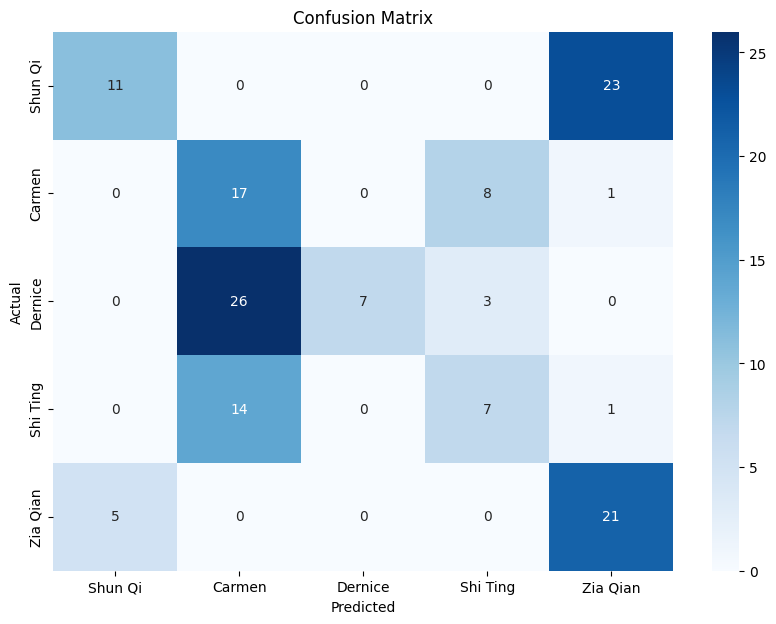

In [105]:
conf_matrix = confusion_matrix(y_test, y_pred_classes)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_strings, yticklabels=class_labels_strings)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [106]:
# Analyze the results
correct_indices = np.where(y_pred_classes == y_test)[0]
incorrect_indices = np.where(y_pred_classes != y_test)[0]

print(f"Correct predictions: {len(correct_indices)}")
print(f"Incorrect predictions: {len(incorrect_indices)}")

Correct predictions: 63
Incorrect predictions: 81


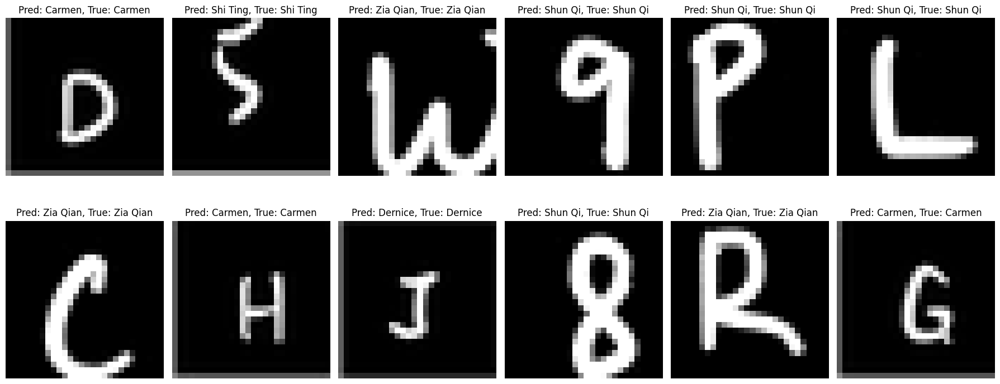

In [107]:
X_images_train, X_images_test, _, _ = train_test_split(X, class_labels, test_size=0.2, random_state=42)

# Display some examples of correct predictions
plt.figure(figsize=(18, 8))
for i, correct in enumerate(correct_indices[:12]):
    plt.subplot(2, 6, i+1)
    plt.imshow(X_images_test[correct], cmap='gray')  # Use original image data for visualization
    plt.title(f"Pred: {index_to_label[y_pred_classes[correct]]}, True: {index_to_label[y_test[correct]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

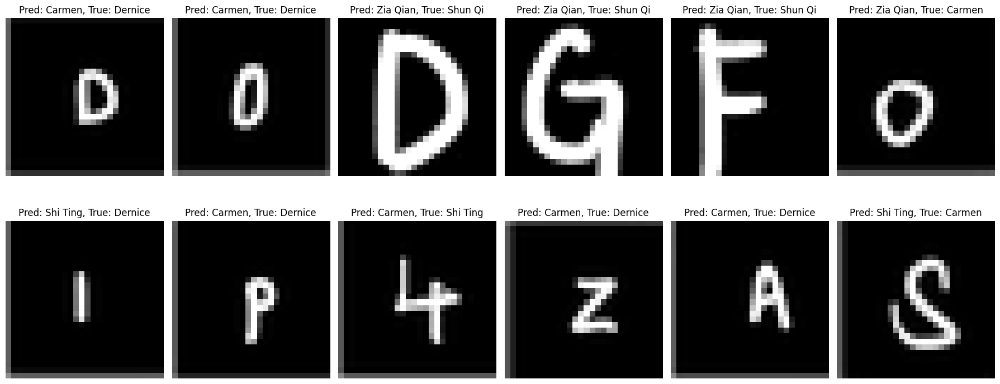

In [108]:
# Display some examples of incorrect predictions
plt.figure(figsize=(18, 8))
for i, incorrect in enumerate(incorrect_indices[:12]):
    plt.subplot(2, 6, i+1)
    plt.imshow(X_images_test[incorrect], cmap='gray')  # Use original image data for visualization
    plt.title(f"Pred: {index_to_label[y_pred_classes[incorrect]]}, True: {index_to_label[y_test[incorrect]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [109]:
accuracy_per_class = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
for i, accuracy in enumerate(accuracy_per_class):
    print(f"Accuracy for class {index_to_label[i]}: {accuracy:.2f}")

best_class_index = np.argmax(accuracy_per_class)
worst_class_index = np.argmin(accuracy_per_class)

Accuracy for class Shun Qi: 0.32
Accuracy for class Carmen: 0.65
Accuracy for class Dernice: 0.19
Accuracy for class Shi Ting: 0.32
Accuracy for class Zia Qian: 0.81


In [110]:
print(f"Best accuracy: {index_to_label[best_class_index]} with {accuracy_per_class[best_class_index]:.2f}")
print(f"Worst accuracy: {index_to_label[worst_class_index]} with {accuracy_per_class[worst_class_index]:.2f}")

Best accuracy: Zia Qian with 0.81
Worst accuracy: Dernice with 0.19


In [111]:
# Find indices of correct predictions for the best and worst classes
best_correct_indices = np.where((y_test == best_class_index) & (y_pred_classes == y_test))[0]
worst_correct_indices = np.where((y_test == worst_class_index) & (y_pred_classes == y_test))[0]

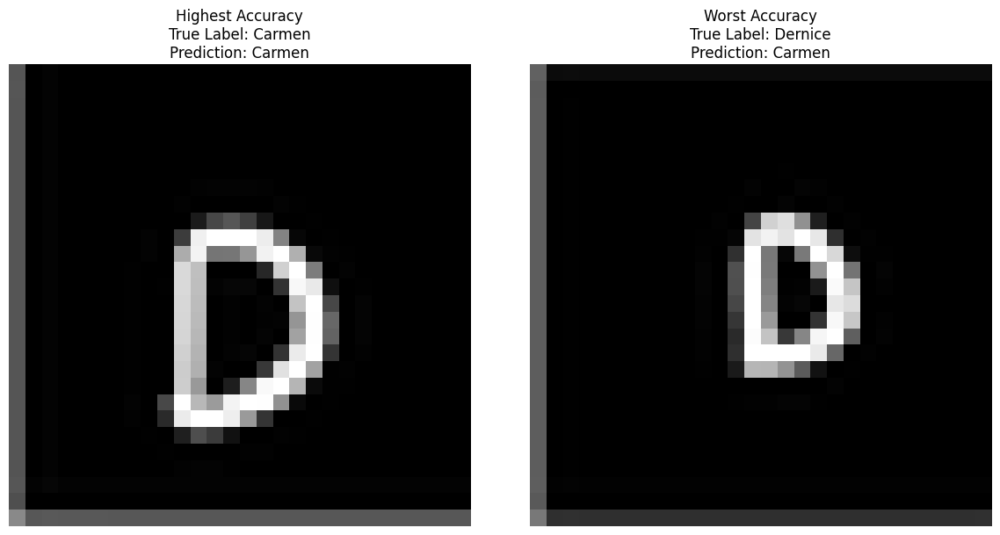

In [112]:
# Find indices of correct predictions for the highest accuracy
highest_accuracy_correct_indices = np.where(y_pred_classes == y_test)[0]

# Find indices of correct predictions for the worst accuracy
worst_accuracy_correct_indices = np.where(y_pred_classes != y_test)[0]

# Display images with the highest accuracy
if highest_accuracy_correct_indices.size > 0:
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    highest_accuracy_index = highest_accuracy_correct_indices[0]
    plt.imshow(X_images_test[highest_accuracy_index], cmap='gray')
    plt.title(f"Highest Accuracy\nTrue Label: {index_to_label[y_test[highest_accuracy_index]]}\nPrediction: {index_to_label[y_pred_classes[highest_accuracy_index]]}")
    plt.axis('off')
else:
    print("No correct predictions found for the highest accuracy.")

# Display images with the worst accuracy
if worst_accuracy_correct_indices.size > 0:
    plt.subplot(1, 2, 2)
    worst_accuracy_index = worst_accuracy_correct_indices[0]
    plt.imshow(X_images_test[worst_accuracy_index], cmap='gray')
    plt.title(f"Worst Accuracy\nTrue Label: {index_to_label[y_test[worst_accuracy_index]]}\nPrediction: {index_to_label[y_pred_classes[worst_accuracy_index]]}")
    plt.axis('off')
else:
    print("No correct predictions found for the worst accuracy.")

plt.tight_layout()
plt.show()

# LIME

In [26]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=becc76b342c771d30095ff284138043904f66080fbae3a61a347af640952e477
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [113]:
print("Shape of X:", X_train.shape)
print("Shape of Y:", y_train.shape)

Shape of X: (576, 5)
Shape of Y: (576,)


157/157 [==============================] - 0s 2ms/step


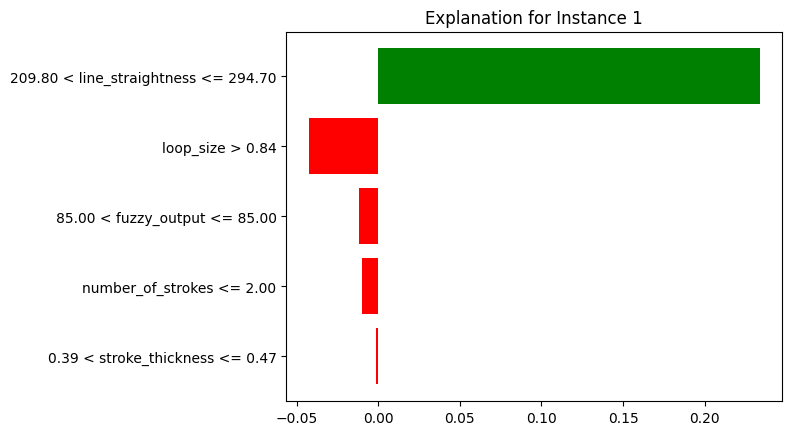

157/157 [==============================] - 0s 2ms/step


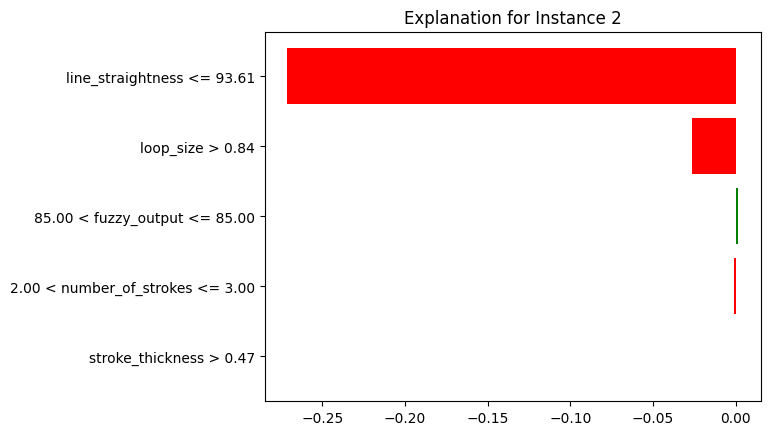

157/157 [==============================] - 0s 2ms/step


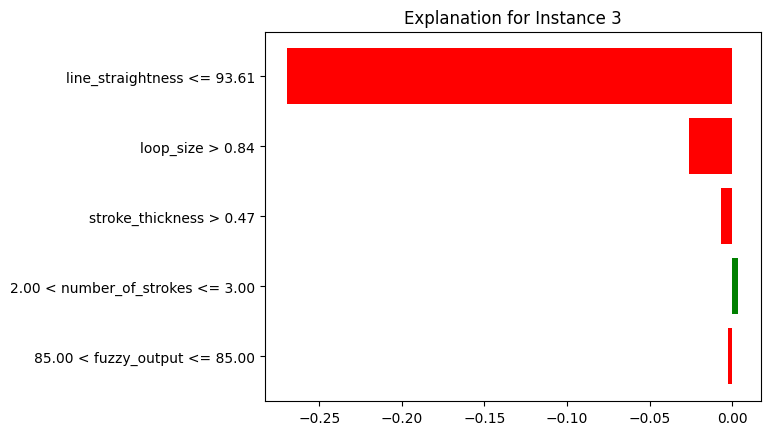

157/157 [==============================] - 0s 3ms/step


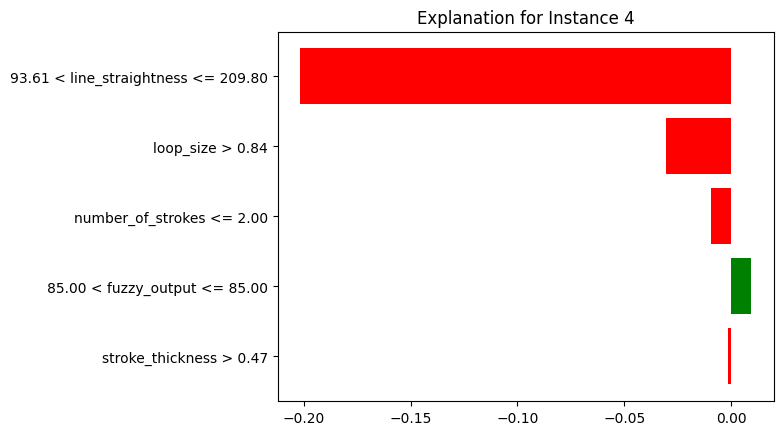

157/157 [==============================] - 1s 3ms/step


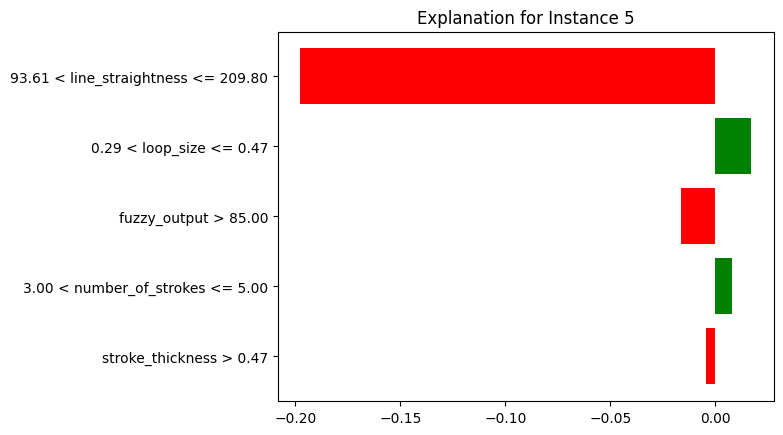

157/157 [==============================] - 1s 3ms/step


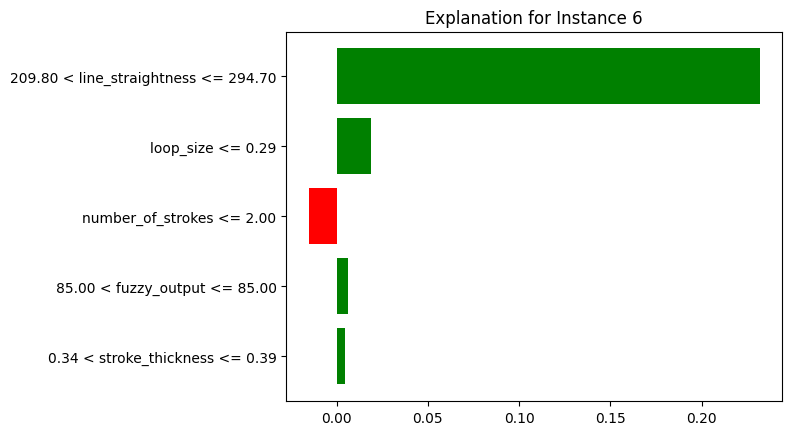

157/157 [==============================] - 0s 2ms/step


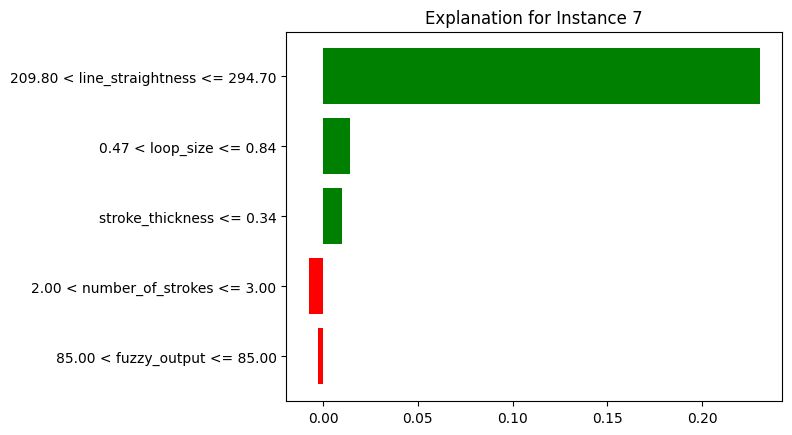

157/157 [==============================] - 1s 3ms/step


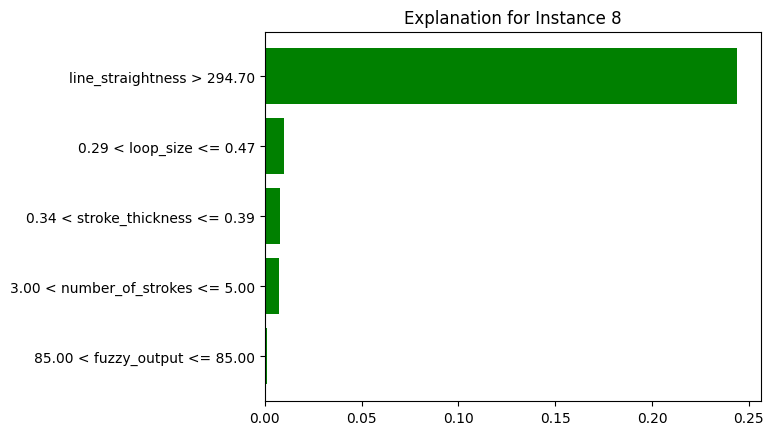

157/157 [==============================] - 1s 3ms/step


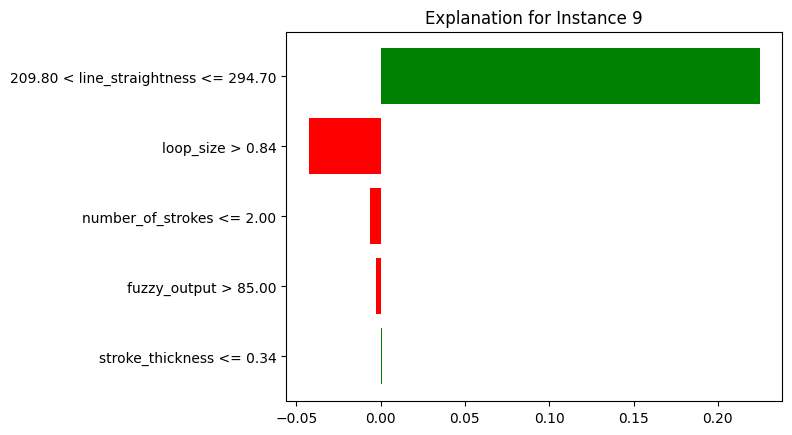

157/157 [==============================] - 0s 2ms/step


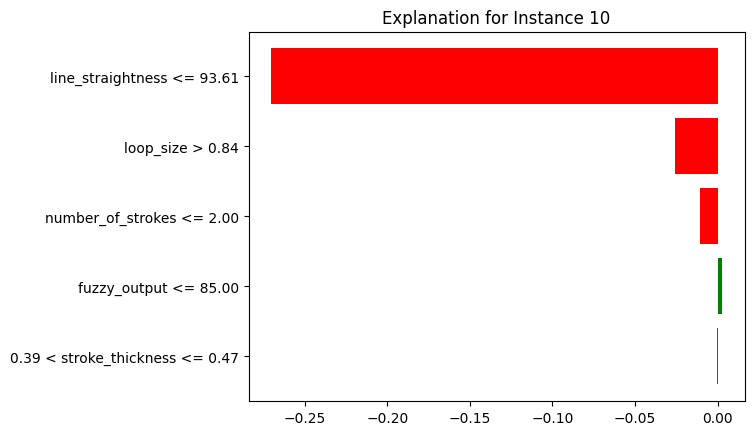

In [114]:
import lime
import lime.lime_tabular

feature_names_list = ['stroke_thickness', 'number_of_strokes', 'line_straightness', 'loop_size', 'fuzzy_output']

explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=feature_names_list,
    class_names=["Shun Qi", "Carmen", "Dernice", "Shi Ting", "Zia Qian"],  
    discretize_continuous=True
)


def predict_fn(features):
    return model.predict(features)


def explain_and_visualize(instance, index):
    explanation = explainer.explain_instance(
        instance,
        predict_fn,  
        num_features=5,  
        top_labels=5  
    )

    # Display the explanation
    explanation.show_in_notebook(show_all=False)
    explanation.as_pyplot_figure()
    plt.title(f'Explanation for Instance {index + 1}')
    plt.show()

for i in range(min(10, len(X_train))):
    explain_and_visualize(X_train[i], i)


# Genetic Algorithm

In [29]:
pip install deap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 1.3 MB/s eta 0:00:00


In [30]:
import numpy as np
from deap import base, creator, tools, algorithms
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam, RMSprop, SGD
from keras.utils import to_categorical

In [31]:
def evaluate_nn(individual):
    learning_rate = individual[0]
    batch_size = int(individual[1])
    num_epochs = int(individual[2])
    num_layers = int(individual[3])
    num_neurons = int(individual[4])
    dropout_rate = individual[5]
    use_batch_norm = bool(individual[6])

    if not 0 <= dropout_rate < 1:
        dropout_rate = 0.5

    model = Sequential()
    model.add(Dense(num_neurons, input_dim=X_train.shape[1], activation='relu'))
    if use_batch_norm:
        model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))

    for _ in range(num_layers - 1):
        model.add(Dense(num_neurons, activation='relu'))
        if use_batch_norm:
            model.add(BatchNormalization())
        model.add(Dropout(dropout_rate))

    model.add(Dense(num_classes, activation='softmax'))

    optimizer = Adam(learning_rate=learning_rate)

    model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

    model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, verbose=0)

    loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
    return accuracy,

In [32]:
creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)

toolbox = base.Toolbox()

toolbox.register("learning_rate", np.random.uniform, 0.0001, 0.1)
toolbox.register("batch_size", np.random.randint, 16, 128)
toolbox.register("num_epochs", np.random.randint, 10, 100)
toolbox.register("num_layers", np.random.randint, 1, 5)
toolbox.register("num_neurons", np.random.randint, 10, 100)
toolbox.register("dropout_rate", np.random.uniform, 0, 0.5)
toolbox.register("use_batch_norm", np.random.randint, 0, 2) 

In [33]:
toolbox.register("individual", tools.initCycle, creator.Individual,
                 (toolbox.learning_rate, toolbox.batch_size, toolbox.num_epochs,
                  toolbox.num_layers, toolbox.num_neurons, toolbox.dropout_rate, toolbox.use_batch_norm), n=1)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)
toolbox.register("evaluate", evaluate_nn)
toolbox.register("mate", tools.cxOnePoint)
toolbox.register("mutate", tools.mutUniformInt, low=0, up=1, indpb=0.2)
toolbox.register("select", tools.selRoulette)

In [34]:
# Parameters for the genetic algorithm
population_size = 20
num_generations = 10
stagnation_threshold = 10  

In [35]:
population = toolbox.population(n=population_size)
best_fitness_scores = []
stagnation_counter = 0
previous_best_fitness = None
best_individuals = []
final_population = []

In [36]:
for gen in range(num_generations):
    offspring = algorithms.varAnd(population, toolbox, cxpb=0.5, mutpb=0.2)
    fits = toolbox.map(toolbox.evaluate, offspring)
    for fit, ind in zip(fits, offspring):
        ind.fitness.values = fit
        
    population = toolbox.select(offspring, k=len(population))
    best_ind = tools.selBest(population, k=1)[0]
    best_fitness_scores.append(best_ind.fitness.values[0])
    best_individuals.append(best_ind)
    print(f"Generation {gen+1}: Best Fitness = {best_ind.fitness.values[0]}")

    # Check for stagnation
    if previous_best_fitness is None:
        previous_best_fitness = best_ind.fitness.values[0]
    else:
        if best_ind.fitness.values[0] <= previous_best_fitness:
            stagnation_counter += 1
        else:
            stagnation_counter = 0 
            previous_best_fitness = best_ind.fitness.values[0]

    # Terminate early if stagnation threshold is reached
    if stagnation_counter >= stagnation_threshold:
        print(f"Stopping early due to stagnation at generation {gen}")
        break

Generation 1: Best Fitness = 0.5069444179534912
Generation 2: Best Fitness = 0.4861111044883728
Generation 3: Best Fitness = 0.4861111044883728
Generation 4: Best Fitness = 0.4791666567325592
Generation 5: Best Fitness = 0.4652777910232544
Generation 6: Best Fitness = 0.5416666865348816
Generation 7: Best Fitness = 0.5069444179534912
Generation 8: Best Fitness = 0.4652777910232544
Generation 9: Best Fitness = 0.5
Generation 10: Best Fitness = 0.4930555522441864


In [37]:
# Collect the final population
final_population = population

# Print the final population of chromosomes and the best individual
print("\nFinal Population:")
for individual in final_population:
    print("Hyperparameters:",
          "Learning Rate:", individual[0],
          "Batch Size:", individual[1],
          "Num Epochs:", individual[2],
          "Num Layers:", individual[3],
          "Num Neurons:", individual[4],
          "Dropout Rate:", individual[5],
          "Use Batch Norm:", individual[6],
          "Fitness:", individual.fitness.values)

print("\nBest Individual:")
best_individual = best_individuals[-1]
print("Best Hyperparameters:",
      "Learning Rate:", best_individual[0],
      "Batch Size:", best_individual[1],
      "Num Epochs:", best_individual[2],
      "Num Layers:", best_individual[3],
      "Num Neurons:", best_individual[4],
      "Dropout Rate:", best_individual[5],
      "Use Batch Norm:", best_individual[6],
      "Fitness:", best_individual.fitness.values)


Final Population:
Hyperparameters: Learning Rate: 0.03468615477332395 Batch Size: 127 Num Epochs: 30 Num Layers: 1 Num Neurons: 54 Dropout Rate: 0.050368344725213676 Use Batch Norm: 1 Fitness: (0.4097222089767456,)
Hyperparameters: Learning Rate: 0.041981597330988135 Batch Size: 0 Num Epochs: 1 Num Layers: 3 Num Neurons: 54 Dropout Rate: 0.050368344725213676 Use Batch Norm: 0 Fitness: (0.3263888955116272,)
Hyperparameters: Learning Rate: 0.03468615477332395 Batch Size: 75 Num Epochs: 43 Num Layers: 1 Num Neurons: 86 Dropout Rate: 0 Use Batch Norm: 1 Fitness: (0.4444444477558136,)
Hyperparameters: Learning Rate: 0.03468615477332395 Batch Size: 127 Num Epochs: 30 Num Layers: 1 Num Neurons: 54 Dropout Rate: 0.050368344725213676 Use Batch Norm: 1 Fitness: (0.2777777910232544,)
Hyperparameters: Learning Rate: 0.046093892364468377 Batch Size: 52 Num Epochs: 42 Num Layers: 3 Num Neurons: 54 Dropout Rate: 0 Use Batch Norm: 1 Fitness: (0.3472222089767456,)
Hyperparameters: Learning Rate: 0.039

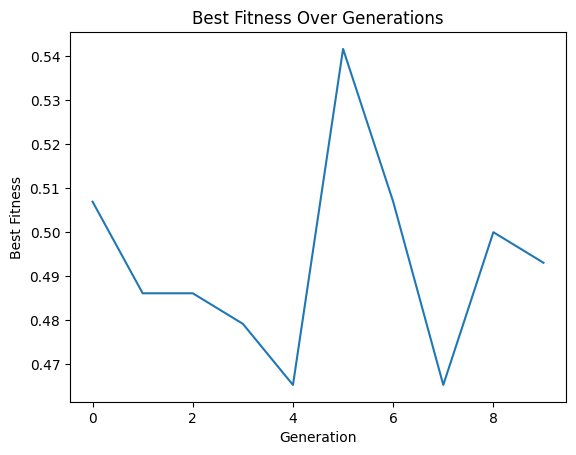

In [38]:
# Plot the best fitness over the number of generations
plt.plot(best_fitness_scores)
plt.xlabel('Generation')
plt.ylabel('Best Fitness')
plt.title('Best Fitness Over Generations')
plt.show()

# Optimized neural network model using best individual

In [39]:
import numpy as np
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam, RMSprop, SGD
from keras.utils import to_categorical

In [53]:
# Train a new neural network using the best hyperparameters
learning_rate = best_individual[0]
batch_size = int(best_individual[1])
num_epochs = int(best_individual[2])
num_layers = int(best_individual[3])
num_neurons = int(best_individual[4])
dropout_rate = best_individual[5]
batch_norm = best_individual[6]

# Create the neural network model
model = Sequential()
model.add(Dense(num_neurons, input_dim=X_train.shape[1], activation='relu'))
if batch_norm:
    model.add(BatchNormalization())
model.add(Dropout(dropout_rate))

for _ in range(num_layers - 1):
    model.add(Dense(num_neurons, activation='relu'))
    if batch_norm:
        model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))

model.add(Dense(num_classes, activation='softmax'))

# Use Adam optimizer with specified learning rate
optimizer = Adam(learning_rate=learning_rate)

model.compile(loss='sparse_categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

In [41]:
# Print model summary
print(model.summary())

Model: "sequential_201"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_596 (Dense)           (None, 54)                324       
                                                                 
 batch_normalization_189 (B  (None, 54)                216       
 atchNormalization)                                              
                                                                 
 dropout_395 (Dropout)       (None, 54)                0         
                                                                 
 dense_597 (Dense)           (None, 54)                2970      
                                                                 
 batch_normalization_190 (B  (None, 54)                216       
 atchNormalization)                                              
                                                                 
 dropout_396 (Dropout)       (None, 54)             

In [90]:
# Train the model and store the history
hist = model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, validation_split=0.2)

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

Epoch 1/42
9/9 [==============================] - 0s 15ms/step - loss: 0.7953 - accuracy: 0.5848 - val_loss: 1.9905 - val_accuracy: 0.3793
Epoch 2/42
9/9 [==============================] - 0s 8ms/step - loss: 0.7526 - accuracy: 0.6370 - val_loss: 1.6645 - val_accuracy: 0.4224
Epoch 3/42
9/9 [==============================] - 0s 10ms/step - loss: 0.7943 - accuracy: 0.6283 - val_loss: 0.9629 - val_accuracy: 0.5690
Epoch 4/42
9/9 [==============================] - 0s 10ms/step - loss: 0.7713 - accuracy: 0.6065 - val_loss: 0.8176 - val_accuracy: 0.5948
Epoch 5/42
9/9 [==============================] - 0s 10ms/step - loss: 0.7643 - accuracy: 0.6304 - val_loss: 0.8953 - val_accuracy: 0.5603
Epoch 6/42
9/9 [==============================] - 0s 10ms/step - loss: 0.7614 - accuracy: 0.6630 - val_loss: 1.2152 - val_accuracy: 0.4224
Epoch 7/42
9/9 [==============================] - 0s 9ms/step - loss: 0.7674 - accuracy: 0.6413 - val_loss: 1.0709 - val_accuracy: 0.4914
Epoch 8/42
9/9 [=============

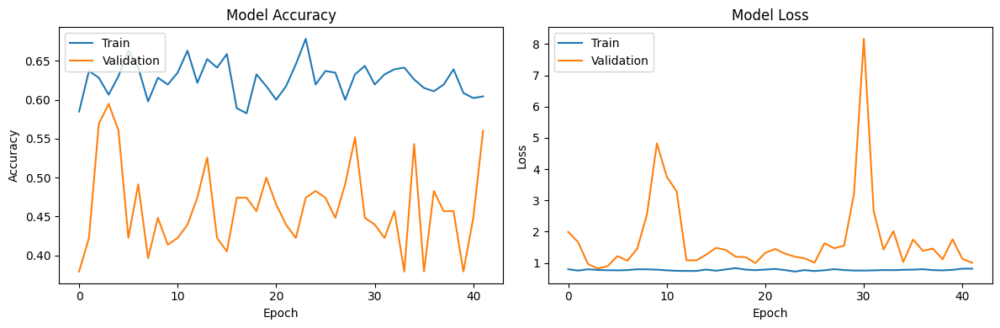

In [91]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(hist.history['accuracy'], label='Train')
plt.plot(hist.history['val_accuracy'], label='Validation')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(hist.history['loss'], label='Train')
plt.plot(hist.history['val_loss'], label='Validation')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper left')

plt.tight_layout()
plt.show()

In [92]:
# Predict the labels for the test set
y_pred = model.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)

5/5 [==============================] - 0s 3ms/step


In [93]:
# Classification report
print(classification_report(y_test, y_pred_classes, target_names=class_labels_strings))

              precision    recall  f1-score   support

     Shun Qi       0.68      0.50      0.58        34
      Carmen       0.83      0.19      0.31        26
     Dernice       0.75      0.50      0.60        36
    Shi Ting       0.32      0.77      0.45        22
    Zia Qian       0.50      0.69      0.58        26

    accuracy                           0.52       144
   macro avg       0.62      0.53      0.50       144
weighted avg       0.64      0.52      0.52       144



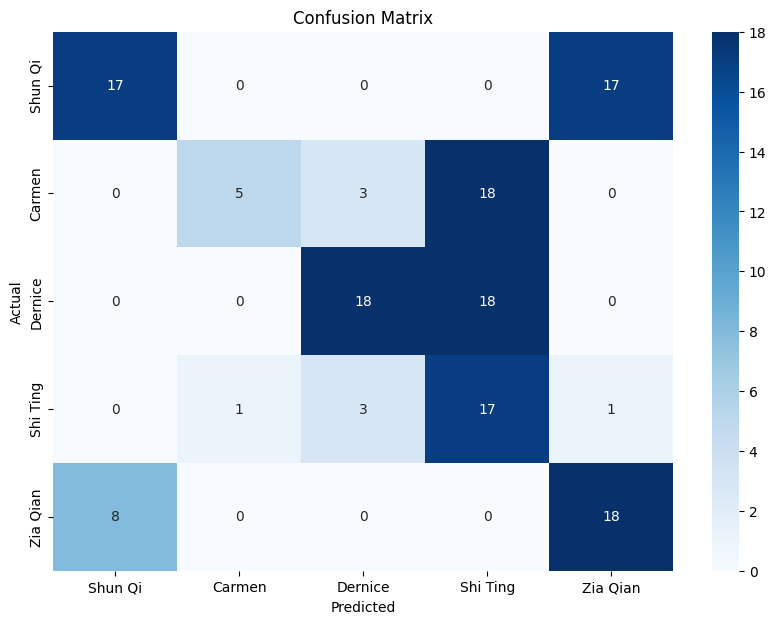

In [94]:
conf_matrix = confusion_matrix(y_test, y_pred_classes)
plt.figure(figsize=(10, 7))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels_strings, yticklabels=class_labels_strings)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [95]:
# Analyze the results
correct_indices = np.where(y_pred_classes == y_test)[0]
incorrect_indices = np.where(y_pred_classes != y_test)[0]

print(f"Correct predictions: {len(correct_indices)}")
print(f"Incorrect predictions: {len(incorrect_indices)}")

Correct predictions: 75
Incorrect predictions: 69


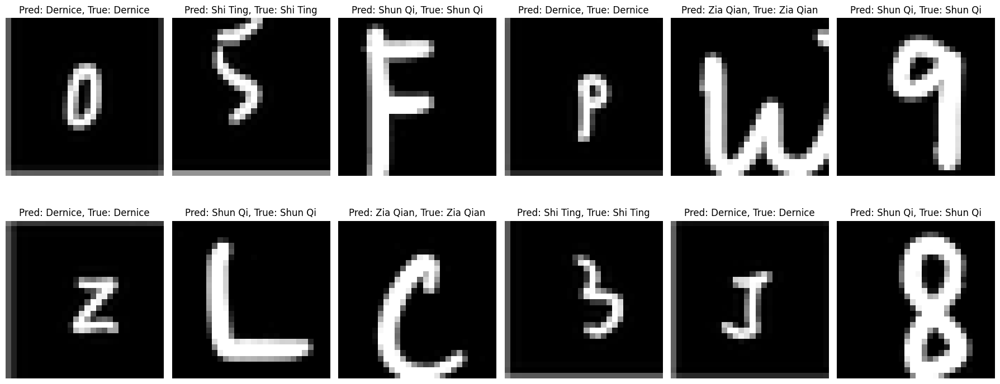

In [96]:
X_images_train, X_images_test, _, _ = train_test_split(X, class_labels, test_size=0.2, random_state=42)

# Display some examples of correct predictions
plt.figure(figsize=(18, 8))
for i, correct in enumerate(correct_indices[:12]):
    plt.subplot(2, 6, i+1)
    plt.imshow(X_images_test[correct], cmap='gray') 
    plt.title(f"Pred: {index_to_label[y_pred_classes[correct]]}, True: {index_to_label[y_test[correct]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

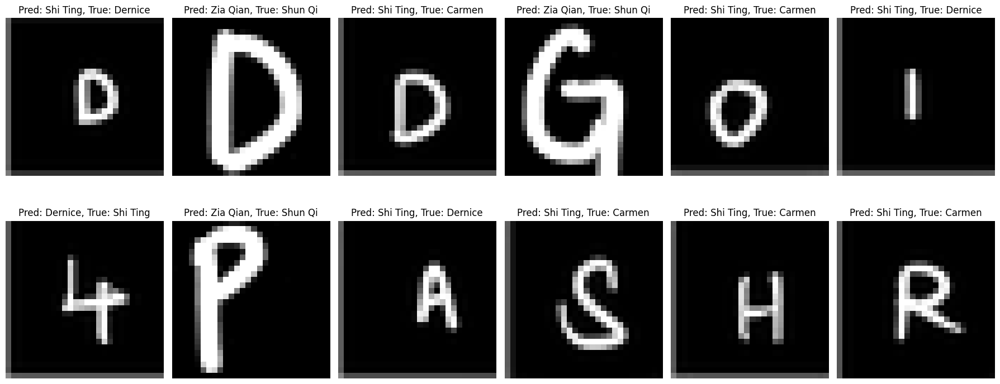

In [97]:
# Display some examples of incorrect predictions
plt.figure(figsize=(18, 8))
for i, incorrect in enumerate(incorrect_indices[:12]):
    plt.subplot(2, 6, i+1)
    plt.imshow(X_images_test[incorrect], cmap='gray')  # Use original image data for visualization
    plt.title(f"Pred: {index_to_label[y_pred_classes[incorrect]]}, True: {index_to_label[y_test[incorrect]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [98]:
accuracy_per_class = conf_matrix.diagonal() / conf_matrix.sum(axis=1)
for i, accuracy in enumerate(accuracy_per_class):
    print(f"Accuracy for class {index_to_label[i]}: {accuracy:.2f}")

best_class_index = np.argmax(accuracy_per_class)
worst_class_index = np.argmin(accuracy_per_class)

Accuracy for class Shun Qi: 0.50
Accuracy for class Carmen: 0.19
Accuracy for class Dernice: 0.50
Accuracy for class Shi Ting: 0.77
Accuracy for class Zia Qian: 0.69


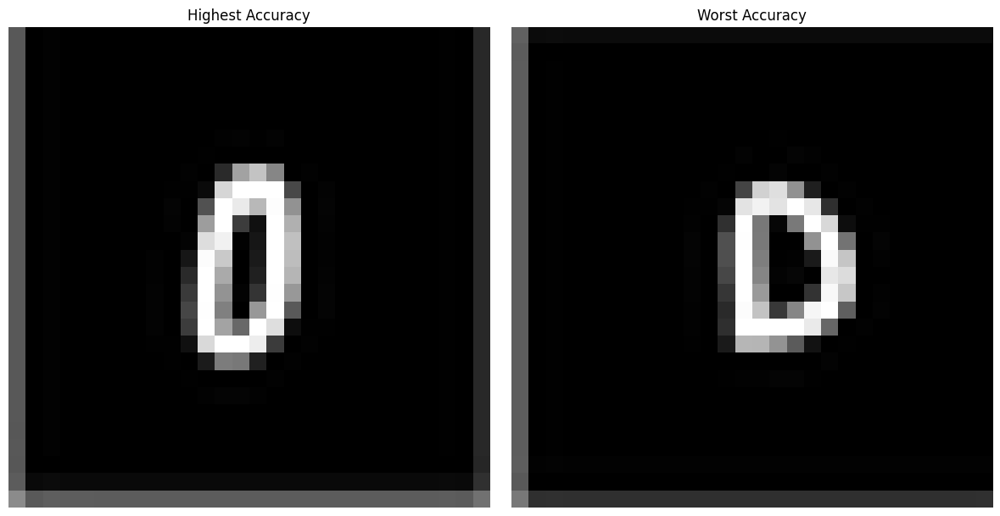

In [99]:
# Find indices of correct predictions for the highest accuracy
highest_accuracy_correct_indices = np.where(y_pred_classes == y_test)[0]

# Find indices of correct predictions for the worst accuracy
worst_accuracy_correct_indices = np.where(y_pred_classes != y_test)[0]

# Display images with the highest accuracy
if highest_accuracy_correct_indices.size > 0:
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    highest_accuracy_index = highest_accuracy_correct_indices[0]
    plt.imshow(X_images_test[highest_accuracy_index], cmap='gray')
    plt.title(f"Highest Accuracy")
    plt.axis('off')
else:
    print("No correct predictions found for the highest accuracy.")

# Display images with the worst accuracy
if worst_accuracy_correct_indices.size > 0:
    plt.subplot(1, 2, 2)
    worst_accuracy_index = worst_accuracy_correct_indices[0]
    plt.imshow(X_images_test[worst_accuracy_index], cmap='gray')
    plt.title(f"Worst Accuracy")
    plt.axis('off')
else:
    print("No correct predictions found for the worst accuracy.")

plt.tight_layout()
plt.show()

# LIME FOR OPTIMIZED MODEL

157/157 [==============================] - 0s 2ms/step


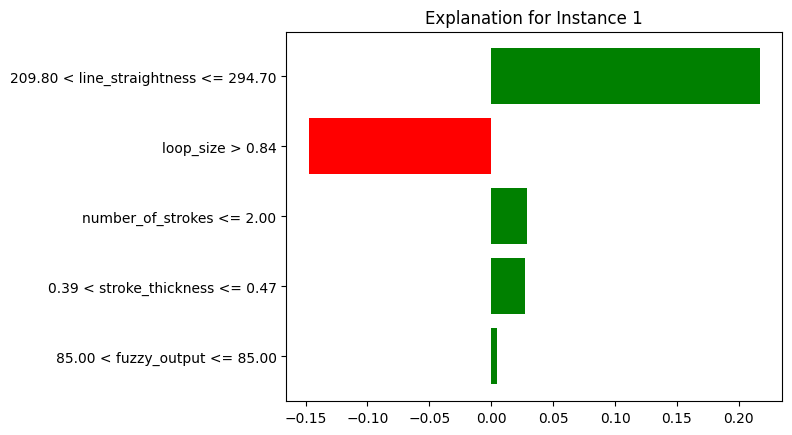

157/157 [==============================] - 0s 2ms/step


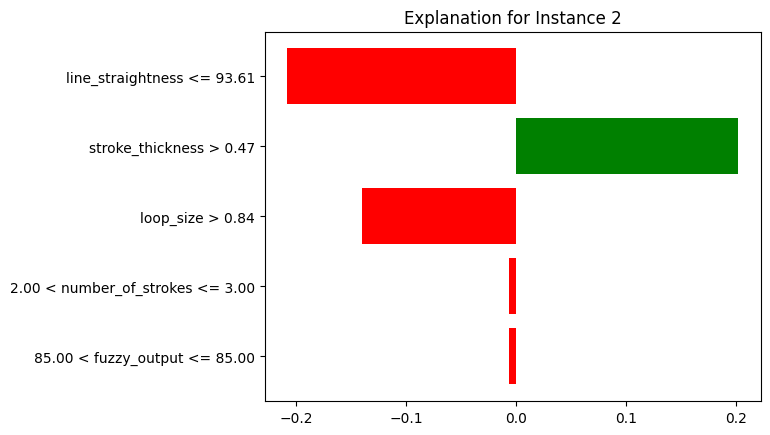

157/157 [==============================] - 1s 3ms/step


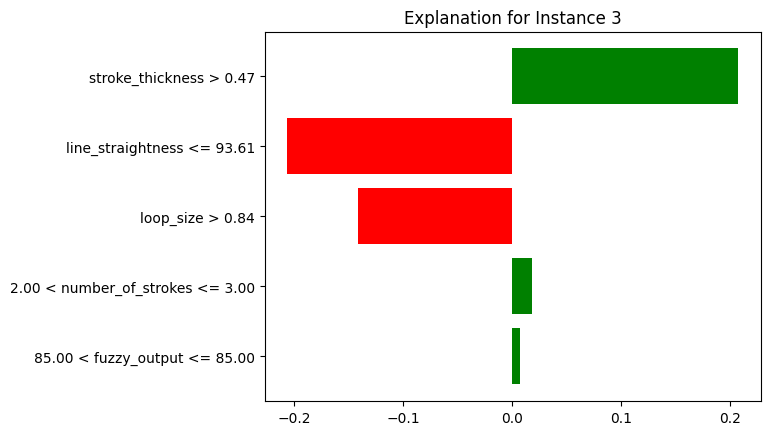

157/157 [==============================] - 1s 3ms/step


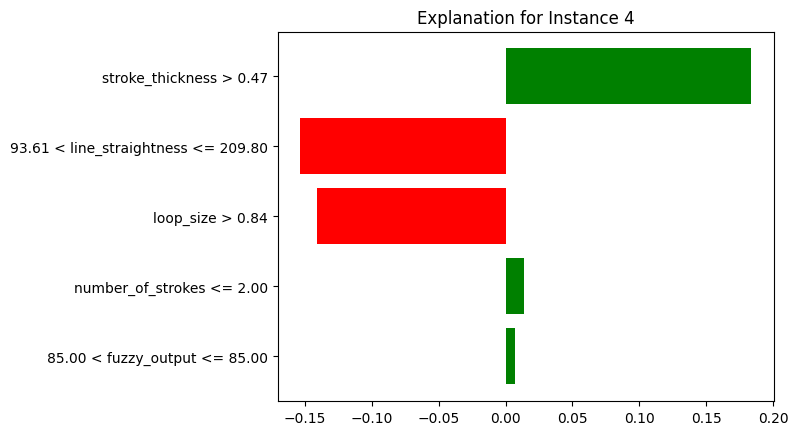

157/157 [==============================] - 0s 3ms/step


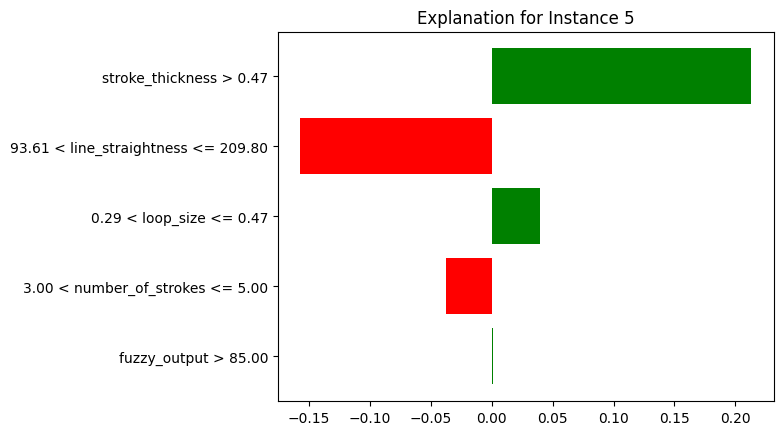

157/157 [==============================] - 1s 3ms/step


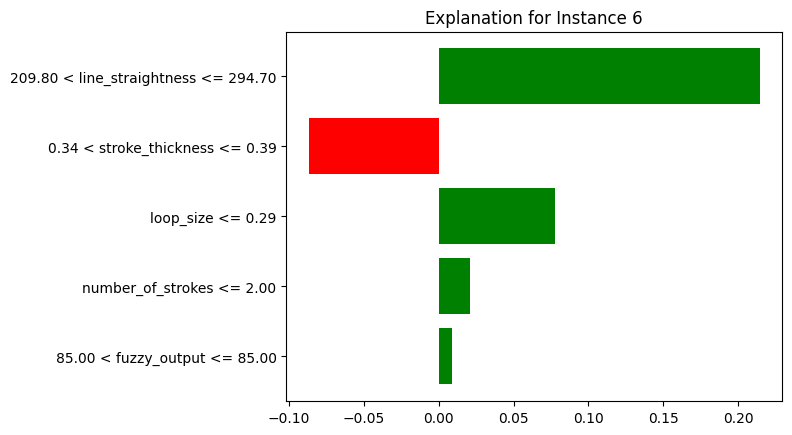

157/157 [==============================] - 0s 3ms/step


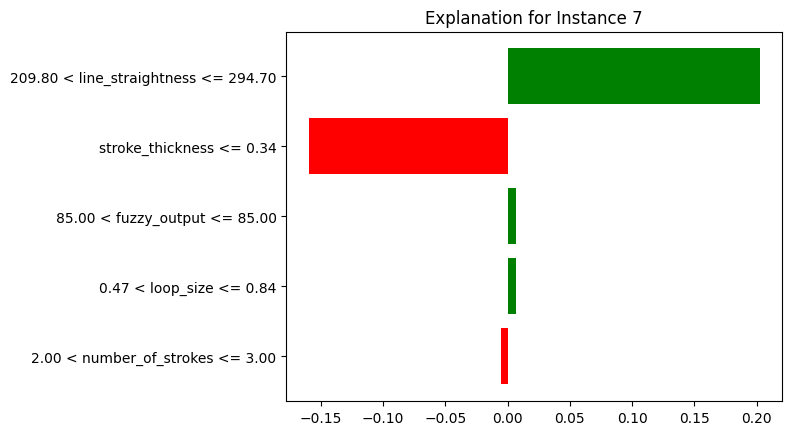

157/157 [==============================] - 0s 3ms/step


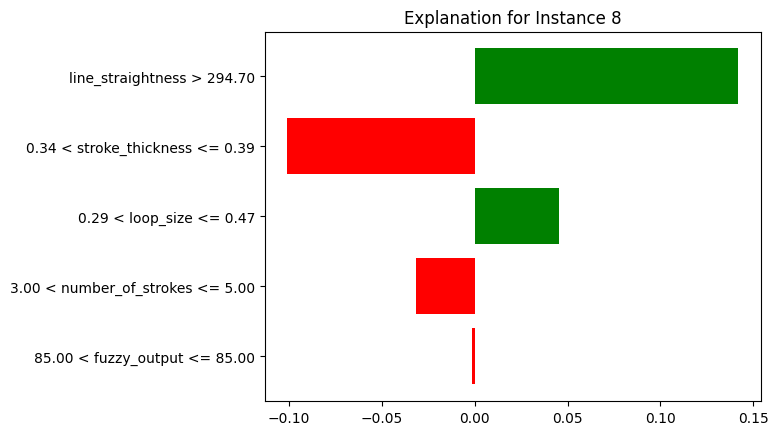

157/157 [==============================] - 0s 3ms/step


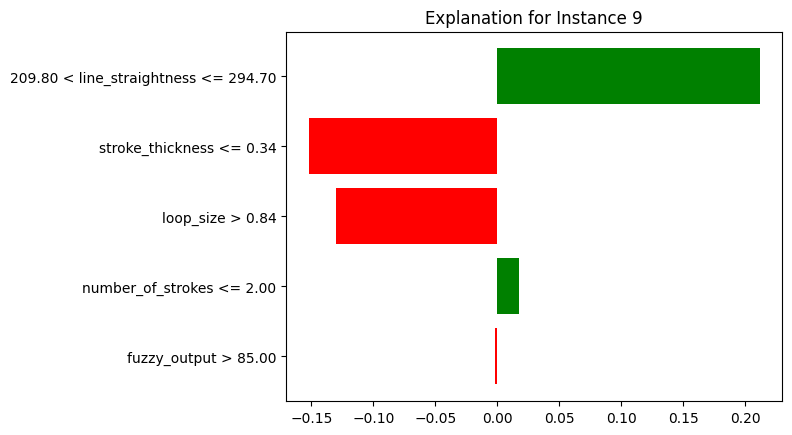

157/157 [==============================] - 0s 2ms/step


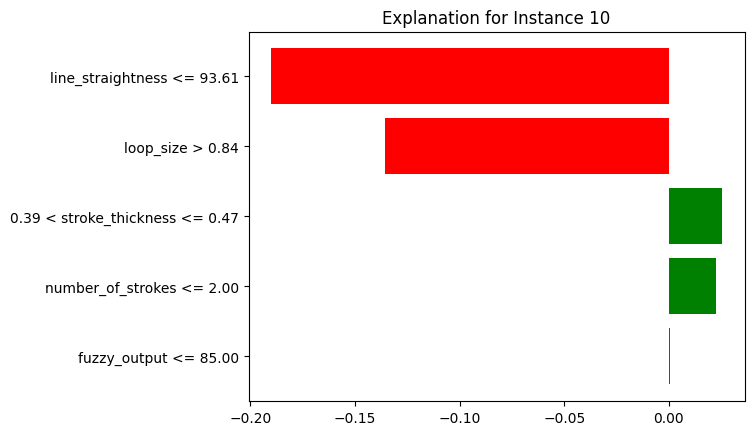

In [100]:
import lime
import lime.lime_tabular

feature_names_list = ['stroke_thickness', 'number_of_strokes', 'line_straightness', 'loop_size', 'fuzzy_output']

explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=feature_names_list,
    class_names=["Shun Qi", "Carmen", "Dernice", "Shi Ting", "Zia Qian"],
    discretize_continuous=True
)


def predict_fn(features):
    return model.predict(features)


def explain_and_visualize(instance, index):
    explanation = explainer.explain_instance(
        instance,
        predict_fn,
        num_features=5,  
        top_labels=5  
    )

    # Display the explanation
    explanation.show_in_notebook(show_all=False)
    explanation.as_pyplot_figure()
    plt.title(f'Explanation for Instance {index + 1}')
    plt.show()

for i in range(min(10, len(X_train))):
    explain_and_visualize(X_train[i], i)